Done:
points 1, 2, 3, 4
<br>
TODO:
5, 6
Live Calibration
Spherical objects
This notebook shows the operations performed on every image to check globally.

In [1]:
#already imports numpy as np, cv2, matplotlib.pyplot 
#as py, os
from CameraCalibration import *
import drawingHelper as dh

In [2]:
#load all images from folder
%load_ext autoreload
%autoreload
imgs = importImagesFolder('../reflex_images/fisheye/')

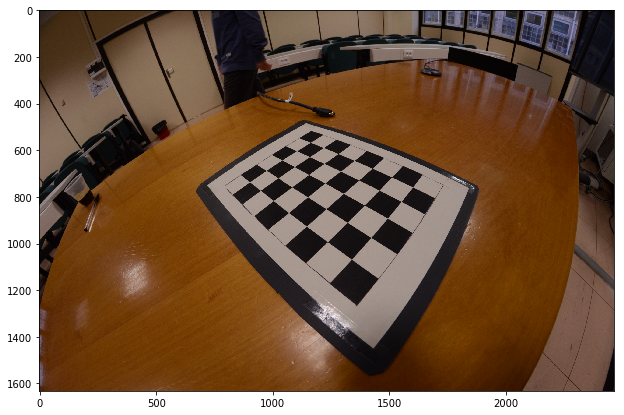

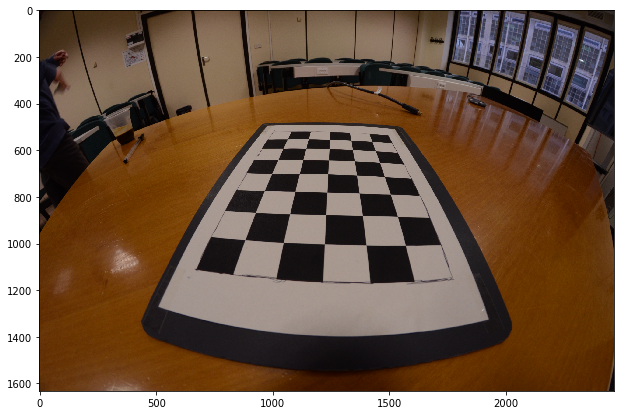

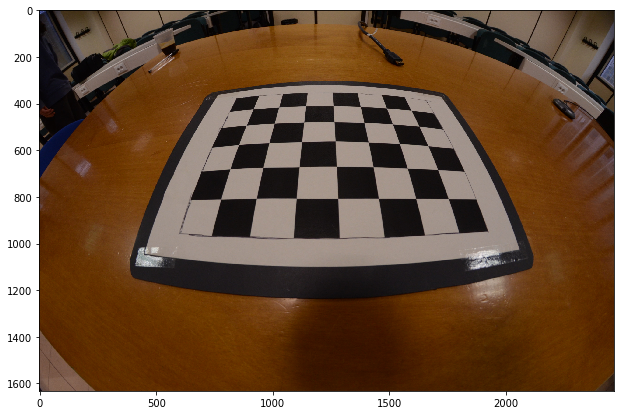

In [3]:
#check if images are loaded correctly
for i in range(3):
    plt.figure(figsize=(15, 7))
    imgplot = plt.imshow(imgs[i])

In [4]:
#detect checkerboard crossings and store object/image points
checkerboardSize = (7,5)
imgs_check, objpoints, imgpoints, checkerFound = \
    detectAndSaveCheckerboardInList(imgs, checkerboardSize)

In [5]:
_, objpoints, imgpoints, checkerFound = detectAndSaveCheckerboardInList(imgs, checkerboardSize)

In [6]:
objpoints[0].shape

(35, 3)

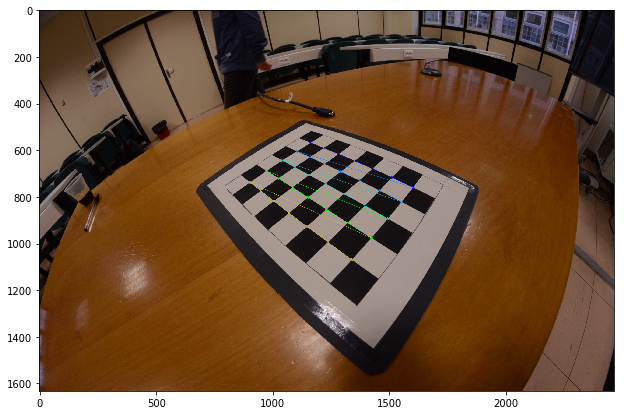

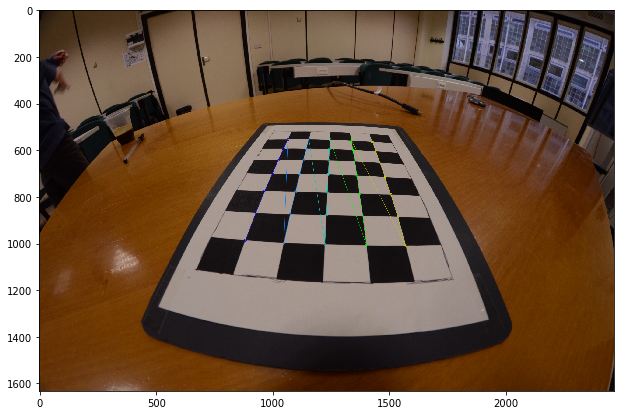

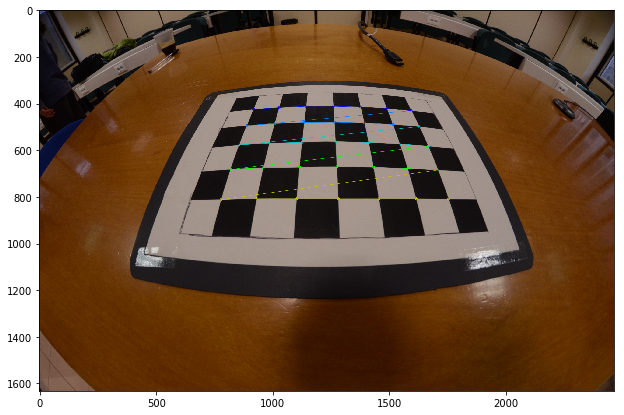

In [7]:


#check if detection was succesfull
for i in range(3):
    plt.figure(figsize=(15, 7))
    imgplot = plt.imshow(imgs_check[i])

In [8]:

    

ret, mtx, dist, rvecs, tvecs = calibrateCamera(objpoints, imgpoints, imgs_check[0].shape[0:2],
               False)

In [9]:
#check that distortion array is all zeros
dist

array([[0., 0., 0., 0., 0.]])

In [10]:
#calculate geometric reprojection error based on lecture slides
#(residual sum of squares) for all calibration images
repError, projPoints = computeReprojectionError(imgpoints, objpoints, rvecs,
                        tvecs, mtx, dist)

repError

[230.69026,
 562.41766,
 3068.7598,
 6432.1,
 1389.8704,
 1088.5226,
 2840.0007,
 1201.0433,
 1553.3785,
 18193.467,
 6927.7905,
 451.37402,
 1770.0511,
 4722.3335,
 14910.879,
 21284.19,
 1313.838,
 779.9644,
 1081.5852,
 2100.2634,
 252.75404,
 724.71655,
 1031.0648,
 327.42453,
 198.72293,
 591.24603,
 4406.999,
 476.7181]

In [11]:
index_max = np.argmax(repError)
print(index_max,repError[index_max])

15 21284.19


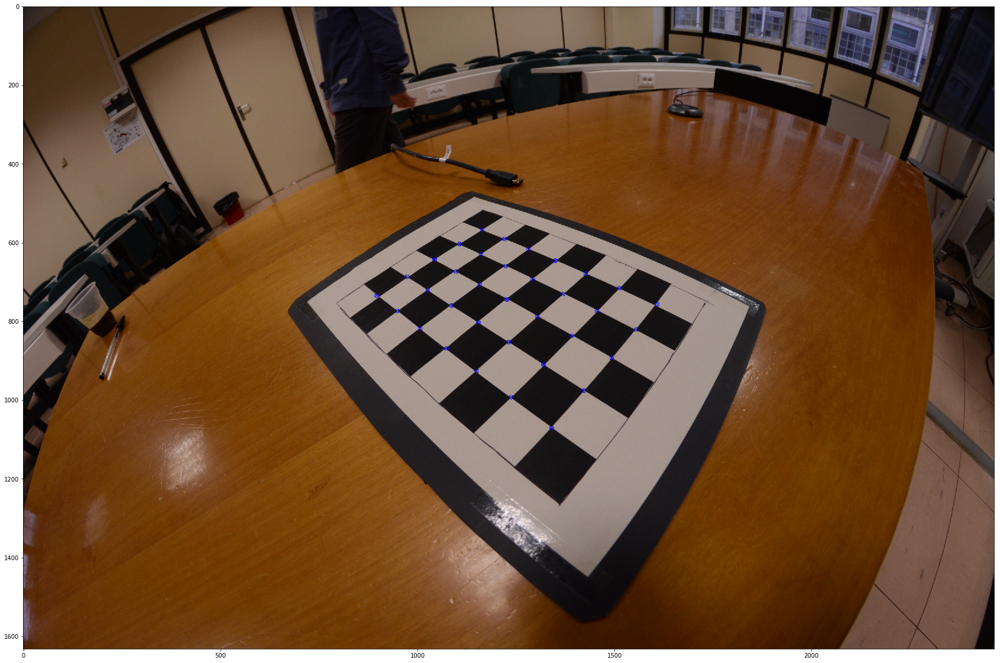

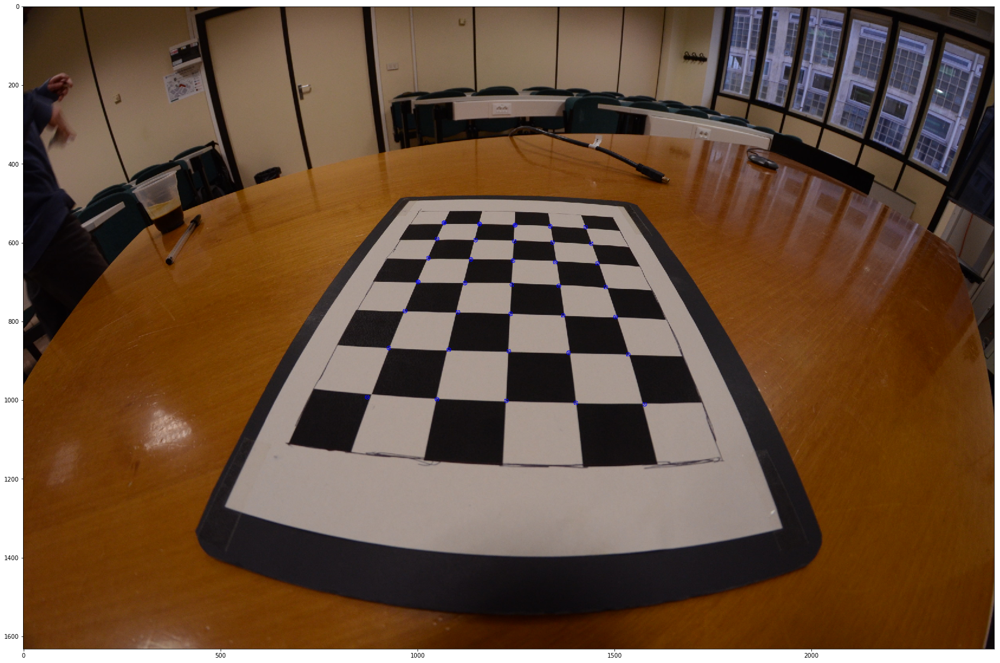

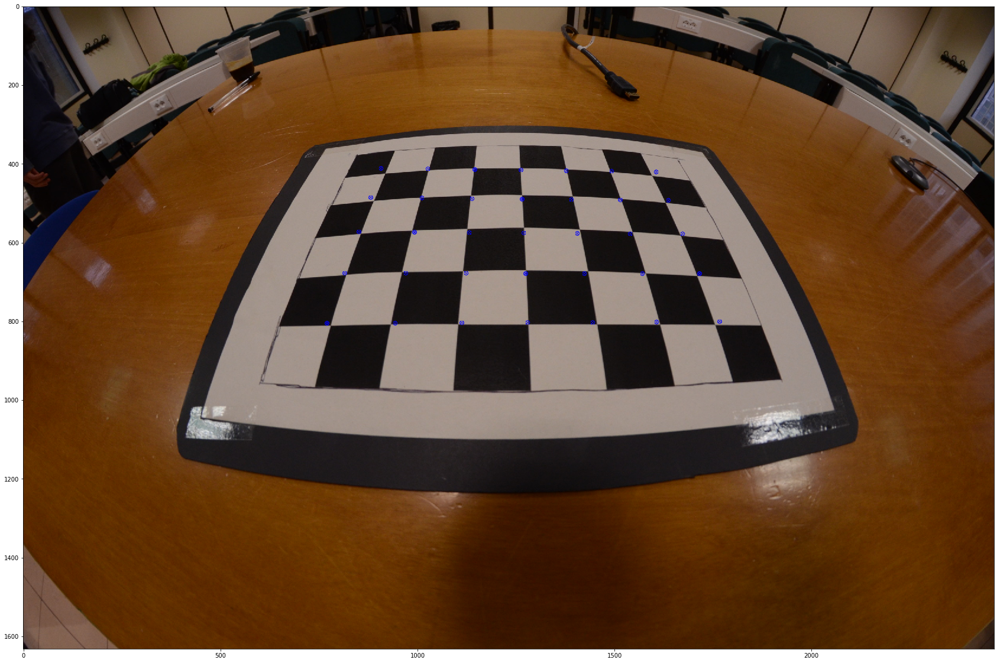

In [12]:
#plot points on image
for i in range(3):
    img_index = i
    if checkerFound[img_index]:
        img2_copy = np.copy(imgs[img_index])
        cv2.drawChessboardCorners(img2_copy, checkerboardSize,
                                  projPoints[img_index], False)
        plt.figure(figsize=(50, 20))
        plt.imshow(img2_copy)
    else:
        print("The image with index " + str(img_index) + " has no checkerboard detected in it.")

In [20]:
#calibrate camera using cv2 function - this will return a
#slightly different version of distortion coefficients
#than the one seen during lectures: this one considers also
#a third coefficient k3
%autoreload
ret, mtx, dist, rvecs, tvecs = calibrateCamera(
    objpoints, imgpoints, imgs_check[0].shape[0:2], True,True)

ret

0.6848701752924102

In [14]:
dist 

array([[-5.72600018,  8.44018613,  0.        ,  0.        ,  1.79943906,
        -5.44380952,  6.77443105,  4.48691317,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ]])

In [15]:
#reprojection error considering radial distortion
repError_dist, projPoints_dist = computeReprojectionError(imgpoints, objpoints, rvecs,
                        tvecs, mtx, dist)

print(repError_dist)

[9.545357, 19.213514, 17.30136, 15.104129, 18.953388, 18.299839, 29.015278, 17.408113, 19.828983, 41.05104, 22.259926, 11.30946, 18.974272, 15.57971, 29.200026, 27.971916, 15.187774, 11.756404, 7.333444, 13.589508, 3.9949708, 5.8972273, 17.638012, 5.8166046, 10.895115, 12.218976, 15.85636, 8.465365]


In [16]:
index_max = np.argmax(repError_dist)
print(index_max,repError_dist[index_max])

9 41.05104


In [17]:
#percentage variation of reprojection error from calibration
#without and with radial distortion
[(x-y)/y for x,y in zip(repError_dist, repError)]
#we see that in all images we have a drop of above 95%

[-0.9586226,
 -0.96583766,
 -0.9943621,
 -0.99765176,
 -0.98636323,
 -0.9831884,
 -0.98978335,
 -0.9855059,
 -0.98723495,
 -0.99774367,
 -0.9967869,
 -0.9749444,
 -0.9892804,
 -0.9967009,
 -0.9980417,
 -0.9986858,
 -0.98844016,
 -0.984927,
 -0.9932197,
 -0.99352956,
 -0.9841943,
 -0.9918627,
 -0.9828934,
 -0.98223525,
 -0.94517434,
 -0.97933346,
 -0.99640197,
 -0.9822424]

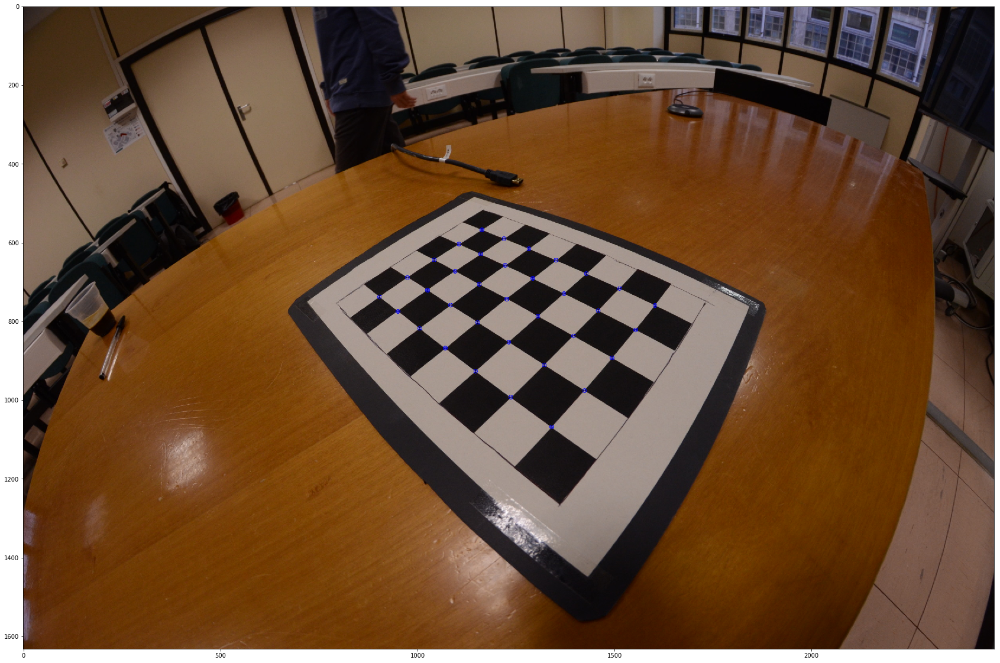

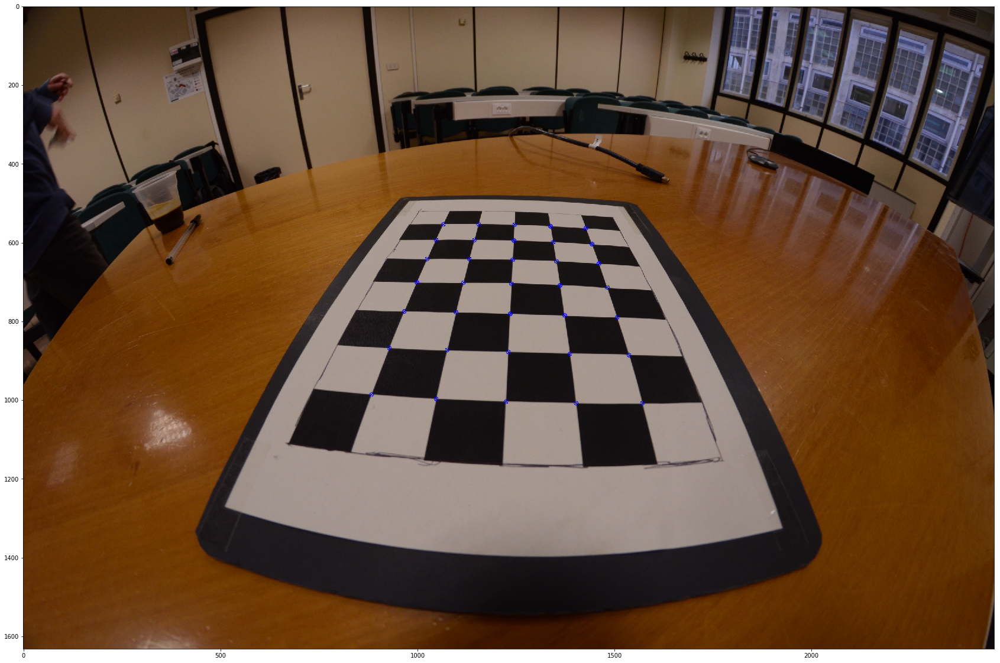

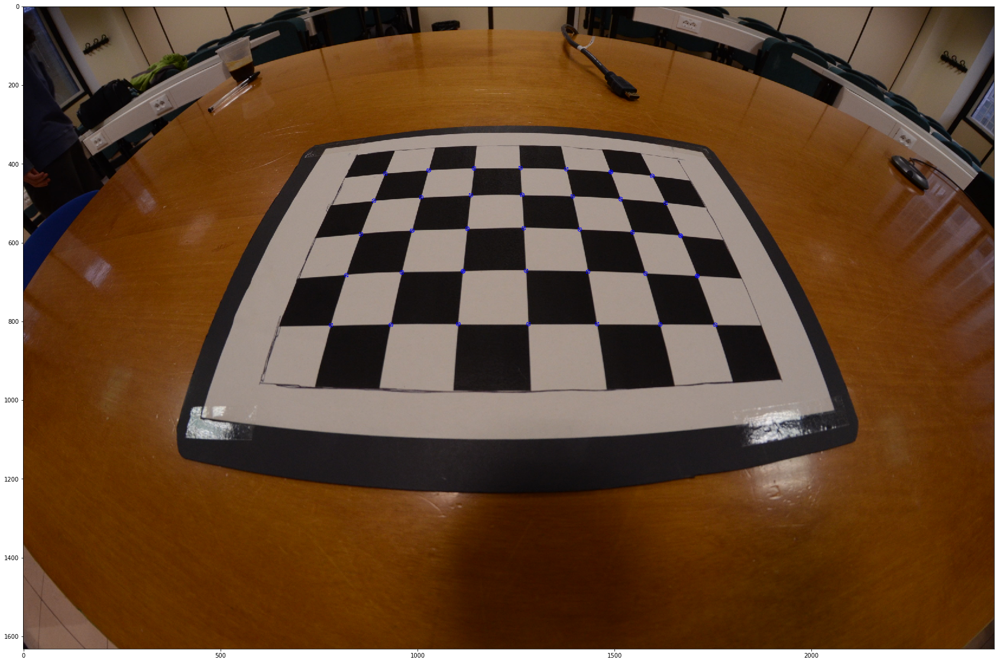

In [18]:
#for comparison sake, before and after on image 3
for i in range(3):
    img_index=i;
    if checkerFound[img_index]:
        img2_copy = np.copy(imgs[img_index])
        cv2.drawChessboardCorners(img2_copy, checkerboardSize,
                                  projPoints_dist[img_index], False)
        plt.figure(figsize=(50, 20))
        plt.imshow(img2_copy)
    else:
        print("The image with index " + str(img_index) + " has no checkerboard detected in it.")

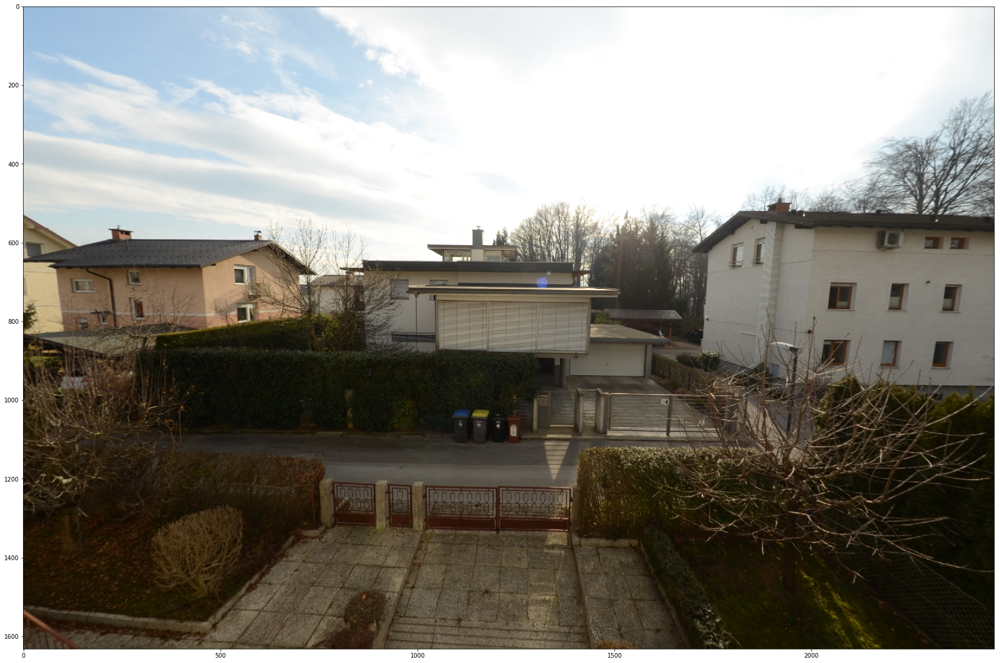

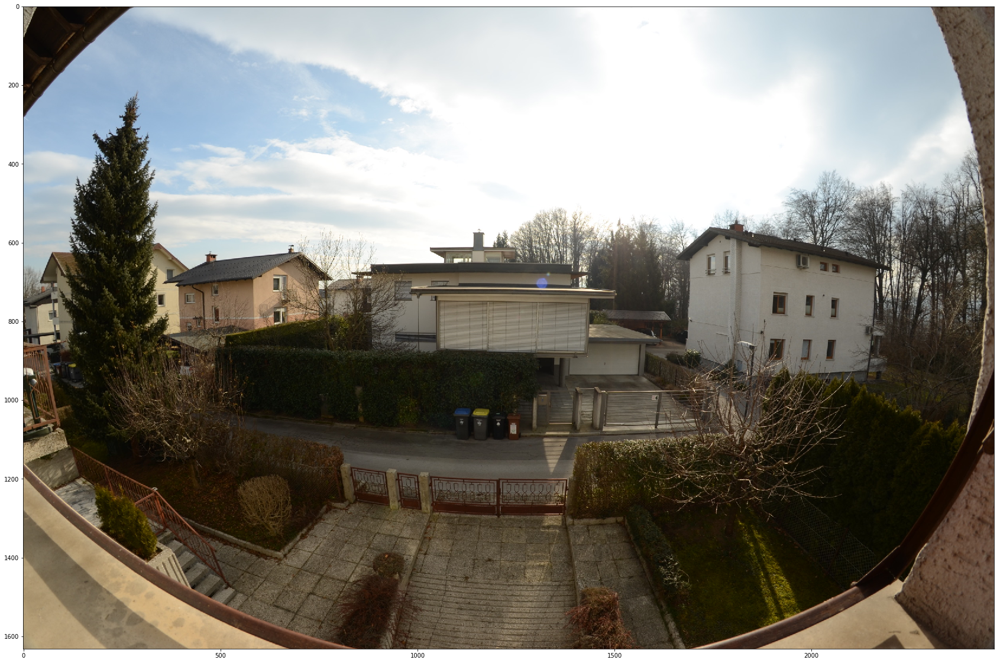

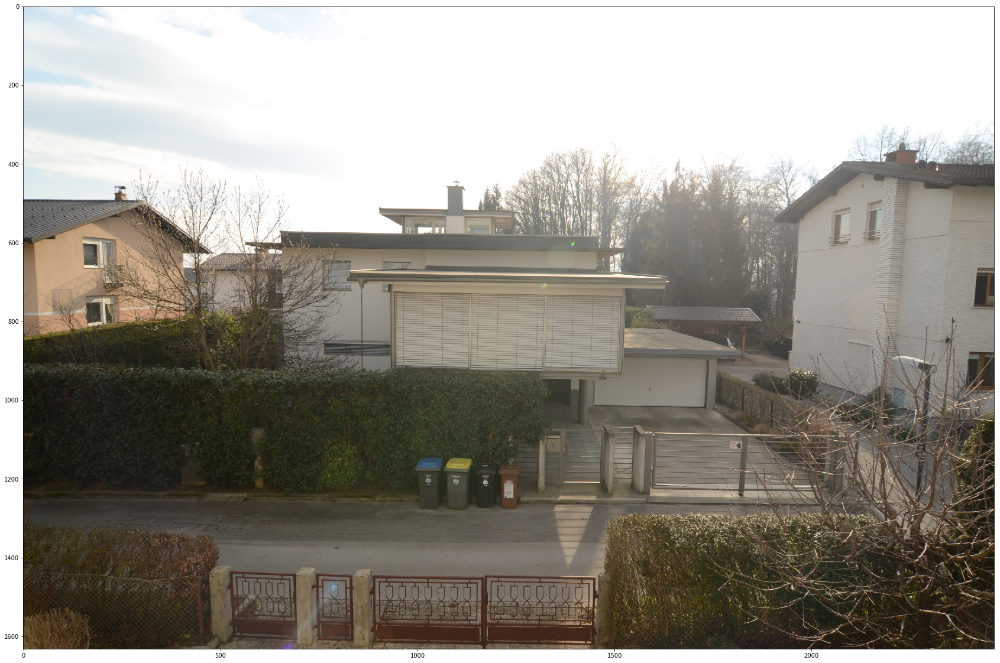

In [29]:
#comparison undistortion
distorted_images = importImagesFolder('../reflex_images/comparisons/1/')
src = np.copy(distorted_images[0])
dst=cv2.undistort(src, mtx, dist)
plt.figure(figsize=(50, 20))
plt.imshow(dst)
plt.figure(figsize=(50, 20))
plt.imshow(src)
tokina12mm=np.copy(distorted_images[1])
plt.figure(figsize=(50, 20))
plt.imshow(tokina12mm)

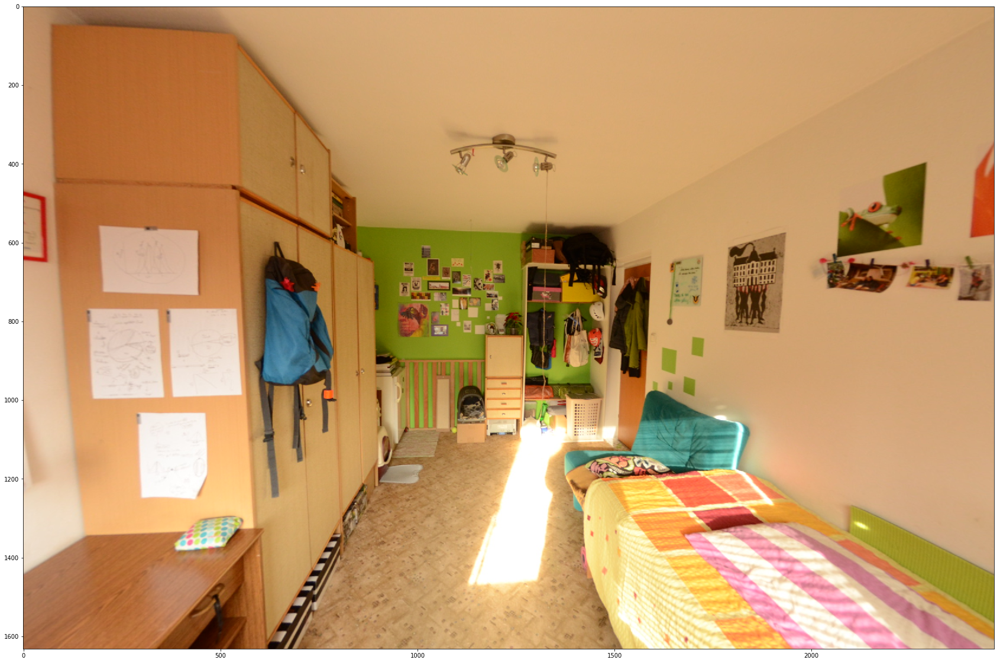

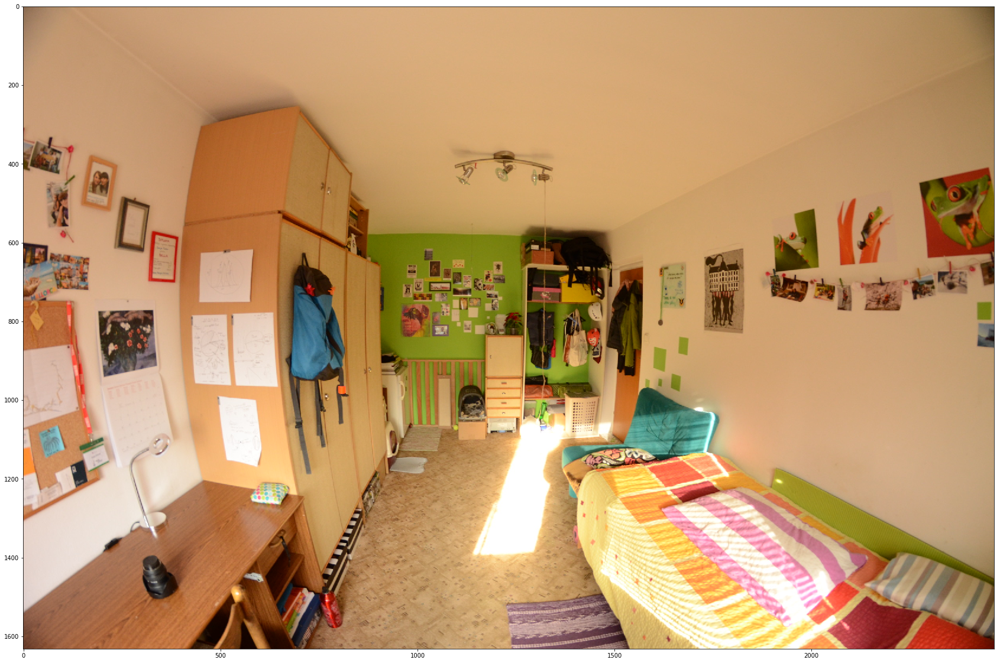

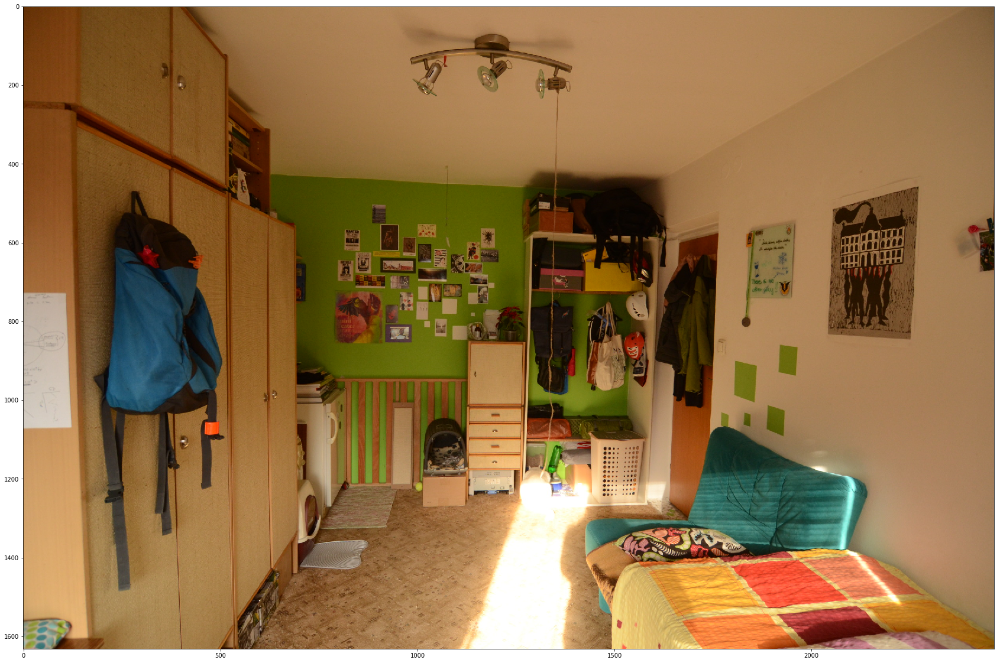

In [31]:
#comparison undistortion
distorted_images = importImagesFolder('../reflex_images/comparisons/2/')
src = np.copy(distorted_images[1])
dst=cv2.undistort(src, mtx, dist)
plt.figure(figsize=(50, 20))
plt.imshow(dst)
plt.figure(figsize=(50, 20))
plt.imshow(src)
tokina12mm=np.copy(distorted_images[0])
plt.figure(figsize=(50, 20))
plt.imshow(tokina12mm)

In [ ]:
img_ind = 4
if checkerFound[img_ind]:
    img = dh.draw_solid('Cylinder', (1.5,1), (3,3), imgs[img_ind], imgpoints[img_ind], mtx, rvecs[img_ind],
                        tvecs[img_ind], dist)
    plt.figure(figsize=(50, 20))
    imgplot = plt.imshow(img)
else:
    print("Checkerboard pattern not found in image with index " + str(img_ind))